In [7]:
import pandas as pd 
import numpy as np 
from matplotlib import pyplot as plt 
from IPython.display import display

## Filter data

In [8]:
def filter_data(data_sent):
    data = data_sent.copy()
    max_flux = -12
    min_flux = 26
    data = data[data['flux_aper']<max_flux]

    data = data[data['significance']>2]
    data_class = data[['class']]

    data_sig = data['significance']
    data_id = data['src_id']
    data_name = data['src_n']
    obs_info_params = [ 'livetime','likelihood','pileup_flag','mstr_sat_src_flag','mstr_streak_src_flag'   ,'gti_obs' , 'flux_significance_b'  , 'flux_significance_m' , 'flux_significance_s' , 'flux_significance_h' , 'flux_significance_u'    ]
    data_val = data.drop(columns=obs_info_params).reset_index(drop=True)
    return data_val

def norm_data(data_sent):
    data = data_sent.copy()
    #data.replace()
    for d in data:
        max_val = np.amax(data[d])
        min_val =  np.amin(data[d])
        data[d] = (data[d]-min_val)/(max_val-min_val)
    return data

In [23]:
def extract_data(data_sent , impute_fn = '',reduce_fn = ' ' , rf_impute=False):
    data = data_sent.copy()
    data = data.sample(frac=1)
    data = filter_data(data)
    #display(data)
    data_id = data[['class' ,'src_n' , 'src_id' ,'significance']]
    data_id = data_id.reset_index(drop=True)
    data_val = data.drop(['index' , 'class' ,'src_n' , 'src_id' ,'significance'] , axis=1)
    return data_val , data_id
    #if(rf_impute):
    #    data_val  , random_forest_imputer = impute_fn(data_val , data_id)
    #else:
    #    data_val = impute_fn(data_val)
    data_val = reduce_fn(data_val)
    data_val = data_val.reset_index(drop=True)
    data_reduced = pd.concat([data_id , data_val] , axis=1)
    if(rf_impute):
        return(data_reduced , random_forest_imputer)
    else:
        return data_reduced

## Load data

In [24]:

train_bh = pd.read_csv('../processed_data/BH_.csv')
train_bh = train_bh.sample(frac=1)

train_ns = pd.read_csv('../processed_data/NS_.csv' )
train_ns = train_ns.sample(frac=1)

train = pd.concat([train_bh , train_ns ] , axis=0)
train =  train.sample(frac=1).reset_index(drop=True)


# RF imputer

In [25]:
from MissingValuesHandler.missing_data_handler import RandomForestImputer

In [21]:
def rf_impute(d, i ):
    data = pd.concat([i , d] , axis=1)
    data = data.drop(columns=['src_n' , 'src_id' , 'significance'])
    rf_imputer = RandomForestImputer(
        data=data , 
        target_variable_name='class' , 
        forbidden_features_list=[] , 
        
    )
    rf_imputer.set_ensemble_model_parameters(n_estimators=400 , additional_estimators=100)
    new_data =  rf_imputer.train(sample_size = 0.3 , path_to_save_dataset='processed_data/rf_imp.csv')
    new_data = new_data.drop(columns= ['class'])
    return new_data , rf_imputer

In [26]:
d , i   = extract_data(train ,  impute_fn= rf_impute , reduce_fn= norm_data , rf_impute=True )
new_data , random_forest_imputer = rf_impute(d, i)
#train_data.index.name = 'index'
#display(train_data.describe())
#train_data.to_csv('../processed_data/train_norm_rf_impute')



- 15815 VALUE(S) CONVERGED!
- 3747 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 15928 VALUE(S) CONVERGED!
- 3634 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 16293 VALUE(S) CONVERGED!
- 3269 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 17843 VALUE(S) CONVERGED!
- 1719 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 18763 VALUE(S) CONVERGED!
- 799 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19075 VALUE(S) CONVERGED!
- 487 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19123 VALUE(S) CONVERGED!
- 439 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19232 VALUE(S) CONVERGED!
- 330 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19283 VALUE(S) CONVERGED!
- 279 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19311 VALUE(S) CONVERGED!
- 251 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19315 VALUE(S) CONVERGED!
- 247 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19328 VALUE(S) CONVERGED!
- 234 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19338 VALUE(S) CONVERGED!
- 224 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19359 VALUE(S) CONVERGED!
- 203 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19365 VALUE(S) CONVERGED!
- 197 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19370 VALUE(S) CONVERGED!
- 192 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19372 VALUE(S) CONVERGED!
- 190 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19384 VALUE(S) CONVERGED!
- 178 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19388 VALUE(S) CONVERGED!
- 174 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19402 VALUE(S) CONVERGED!
- 160 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19412 VALUE(S) CONVERGED!
- 150 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19413 VALUE(S) CONVERGED!
- 149 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19418 VALUE(S) CONVERGED!
- 144 VALUE(S) REMAINING!
- NOT EVERY VALUE CONVERGED. ONTO THE NEXT ROUND OF ITERATIONS...





- 19418 VALUE(S) CONVERGED!
- 144 VALUE(S) REMAINING!
- 144/19562 VALUES UNABLE TO CONVERGE. THE MEDIAN AND/OR THE MODE HAVE BEEN USED AS A REPLACEMENT

- TOTAL ITERATIONS: 120

- NEW DATASET SAVED in: processed_data/rf_imp.csv


In [27]:
sample_used                         = random_forest_imputer.get_sample()
features_type_prediction            = random_forest_imputer.get_features_type_predictions()
target_variable_type_prediction     = random_forest_imputer.get_target_variable_type_prediction()
encoded_features                    = random_forest_imputer.get_encoded_features()
encoded_target_variable             = random_forest_imputer.get_target_variable_encoded()
final_proximity_matrix              = random_forest_imputer.get_proximity_matrix()
final_distance_matrix               = random_forest_imputer.get_distance_matrix()
weighted_averages                   = random_forest_imputer.get_nan_features_predictions(option="all")
convergent_values                   = random_forest_imputer.get_nan_features_predictions(option="conv")
divergent_values                    = random_forest_imputer.get_nan_features_predictions(option="div")
ensemble_model_parameters           = random_forest_imputer.get_ensemble_model_parameters()
all_target_value_predictions        = random_forest_imputer.get_nan_target_values_predictions(option="all")
target_value_predictions            = random_forest_imputer.get_nan_target_values_predictions(option="one")


In [32]:
import seaborn as sns 

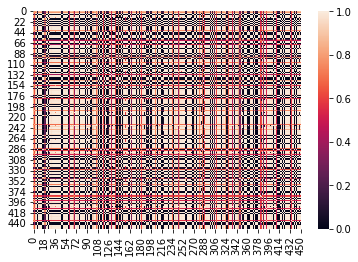

In [36]:
hm = sns.heatmap(
    data = final_proximity_matrix
    height = 
)
plt.show()